- Zoneamento(bhmap)

O novo Plano Diretor de Belo Horizonte, lei 11.181/19, entrou em vigor na quarta-feira, dia 5 (de fevereiro)
https://prefeitura.pbh.gov.br/politica-urbana/regulacao-urbana/informes-tecnicos/plano-diretor-de-belo-horizonte-regulamentado

- Valor do solo (http://www.rmbh.org.br/central-cartog.php?formato=shp)
- Declividade (bhmap)

# Preliminaries

In [1]:
import os
import pathlib
import re
import warnings

import contextily as cx
import fiona
import geobr
import numpy as np
import osmnx as ox
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from rasterstats import zonal_stats
import richdem as rd
import rioxarray
from scipy.stats.mstats import hmean

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
out_folder = os.environ.get('OUT_FOLDER')
out_folder = pathlib.Path(out_folder)
out_folder = out_folder / 'A'

db_folder = os.environ.get('DB_FOLDER')
db_folder = pathlib.Path(db_folder)

# Declividade

A declividade é calculada a partir de um [Modelo Digital de Terreno do Estado de Minas Gerais](https://idesisema.meioambiente.mg.gov.br/geonetwork/srv/api/records/e2544c02-65f3-4380-b78e-76606f08653b). A partir dele, será recortado o município de Belo Horizonte e será obtida a declividade média do terreno, a ser então imputada nas células hexagonais. 

In [3]:
# Limites municipais para extrair BH
# do raster de Minas Gerais
bh = geobr.read_municipality(3106200)

In [4]:
# Lendo raster (EPSG: 4674)
inpath = db_folder / 'beaga/dem_minas_gerais.tiff'
dem_mg = rioxarray.open_rasterio(inpath)

In [5]:
dem_bh = dem_mg.rio.clip(
    bh.geometry.to_numpy(),
    bh.crs,
    )

del dem_mg

Reprojetar é importante para evitar os problemas no cálculo da declividade descritos [aqui](https://stackoverflow.com/questions/70835337/python-calculate-slope-raster-from-dem). Técnicas para fazer isso são apresentadas [aqui](https://www.earthdatascience.org/courses/use-data-open-source-python/intro-raster-data-python/raster-data-processing/reproject-raster/).

In [6]:
# Reprojetando e salvando o raster
dem_bh = dem_bh.rio.reproject(bh.to_crs(31983).crs)

outpath = out_folder / 'dem_bh.tiff'
dem_bh.rio.to_raster(outpath)

In [7]:
slope = rd.TerrainAttribute(
    rd.LoadGDAL(outpath, no_data=-33),
    attrib='slope_percentage',
    )

In [8]:
rd.SaveGDAL(outpath, slope)

In [9]:
inpath = out_folder / 'hexagonos.gpkg'

hexes = (
    gpd
    .read_file(inpath, layer='uso_solo')
    .pipe(lambda x: x.loc[x.ano == 2018])
    .set_index([
        'name_muni',
        'code_muni',
        'aperture',
        'hex_id',
        'ano',
        ])
    )

In [10]:
def mymean(x):
    return hmean(x, nan_policy='propagate')

In [40]:
slope_by_hex = zonal_stats(
    hexes.xs(key=10, level='aperture'),  # Geotable with zones
    outpath,  # Path to surface file
    all_touched=True,
    add_stats={'harmonic_mean': hmean}
)

In [41]:
slope_by_hex = pd.DataFrame(slope_by_hex)

In [42]:
slope_by_hex

,min,max,mean,count,harmonic_mean
0,0.000000,0.000000,0.000000,6,"[0.0, 0.0, 0.0, nan, nan, nan]"
1,1.852587,13.099771,8.029676,27,"[11.61502338967116, 8.106539440202026, 6.88853..."
2,3.314009,12.901777,8.025083,13,"[6.884393070106589, 6.959419086594745, 8.15171..."
3,0.000000,5.239908,1.767596,22,"[2.93664759308534, 4.214006587801265, 2.556545..."
4,0.000000,24.535419,7.046099,27,"[23.138931013976258, 12.879869053407642, 0.0, ..."
...,...,...,...,...,...
20425,21.873087,79.090508,37.875379,28,"[22.144725041988163, 24.85207202704926, 27.770..."
20426,12.619370,23.175859,16.750485,29,"[14.891149534768516, 14.816387497812885, 14.95..."
20427,11.789793,49.492176,21.157868,31,"[17.70956949131297, 16.831815252714446, 19.355..."
20428,4.461621,18.829069,14.178787,29,"[5.868363154555242, 9.795568813101733, 12.8562..."


In [43]:
idx = hexes.xs(key=10, level='aperture').index
slope_by_hex = slope_by_hex.set_axis(idx)

In [44]:
hexes.xs(key=10, level='aperture').merge(slope_by_hex, left_index=True, right_index=True).drop(columns='harmonic_mean').explore('mean', cmap='gist_earth', prefer_camvas=True, )

In [50]:
slope = rd.TerrainAttribute(
    rd.LoadGDAL(outpath, no_data=-33),
    attrib='slope_percentage',
    )

In [31]:
rd.TerrainAttribute?

Signature: rd.TerrainAttribute(dem, attrib, zscale=1.0)
Docstring:
Calculates terrain attributes. A variety of methods are available.

Args:
    dem    (rdarray):  An elevation model
    attrib (str):      Terrain attribute to calculate. (See below.)
    zscale (float):    How much to scale the z-axis by prior to calculation

======================= =========
Method                  Reference
======================= =========
slope_riserun           `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
slope_percentage        `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
slope_degrees           `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
slope_radians           `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
aspect                  `Horn (1981)          

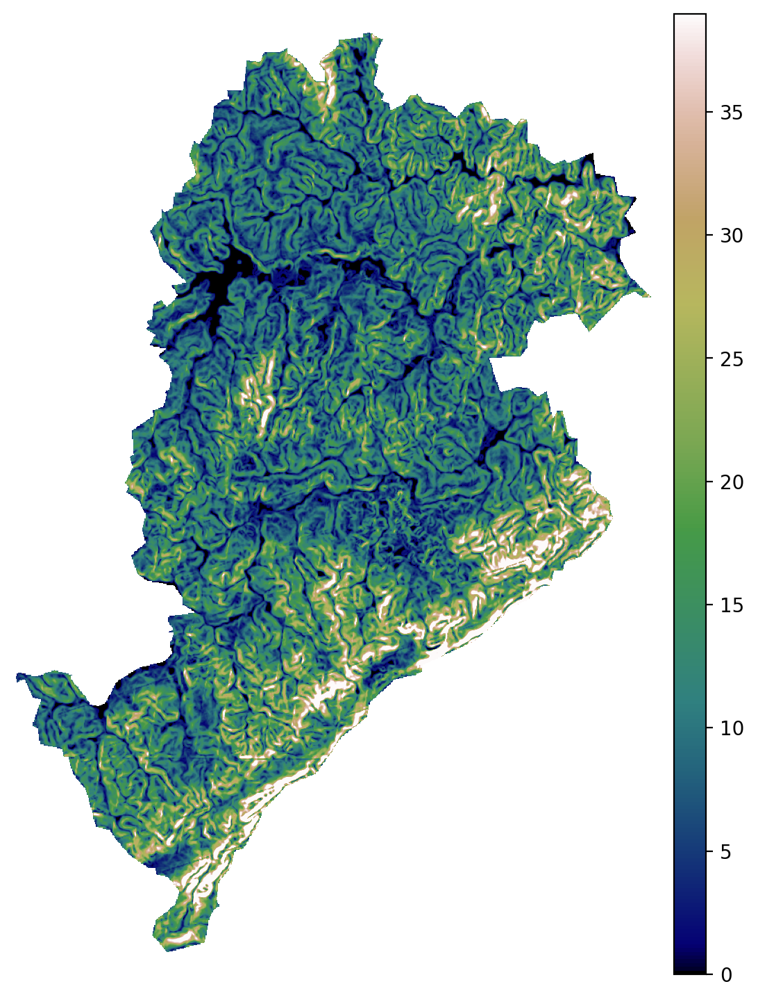

{'vmin': 0.0, 'vmax': 38.97484588623047}

In [32]:
#slope = rd.TerrainAttribute(sp_dem, attrib='slope_percentage')
rd.rdShow(slope, axes=False, cmap='gist_earth', figsize=(6, 5*1.5))

In [28]:
rd.rdShow?

Signature:
rd.rdShow(
    rda,
    ignore_colours=[],
    show=True,
    axes=True,
    cmap='gray',
    vmin=None,
    vmax=None,
    xmin=None,
    xmax=None,
    ymin=None,
    ymax=None,
    zxmin=None,
    zxmax=None,
    zymin=None,
    zymax=None,
    figsize=(4, 4),
    zcolor='red',
    zloc=1,
)
Docstring: <no docstring>
File:      c:\users\brand\anaconda3\envs\roda\lib\site-packages\richdem\__init__.py
Type:      function

In [8]:
dem_bh.values[0, :, :] = np.where(
    np.isclose(slope, -9999),
    -33,
    slope,
    )
del slope

outpath = out_folder / 'dem_bh.tiff'
dem_bh.rio.to_raster(outpath)

In [11]:
slope_by_hex = pd.DataFrame(slope_by_hex)

In [22]:
hmean

<function scipy.stats._stats_py.hmean(a, axis=0, dtype=None, *, weights=None, nan_policy='propagate', keepdims=False)>

In [34]:
foo = rioxarray.open_rasterio(outpath)

In [35]:
foo

<xarray.DataArray (band: 1, y: 32614, x: 40467)> Size: 5GB
[1319790738 values with dtype=float32]
Coordinates:
  * band         (band) int32 4B 1
  * x            (x) float64 324kB -1.533e+05 -1.533e+05 ... 1.055e+06 1.055e+06
  * y            (y) float64 261kB 8.426e+06 8.426e+06 ... 7.452e+06 7.452e+06
    spatial_ref  int32 4B 0
Attributes:
    PROCESSING_HISTORY:  2025-04-04 03:47:38.613567 UTC | RichDEM (Python 2.3...
    AREA_OR_POINT:       Area
    _FillValue:          -9999.0
    scale_factor:        1.0
    add_offset:          0.0

In [14]:
rioxarray.DataArray?

Object `rioxarray.DataArray` not found.


In [12]:
rd.TerrainAttribute?

Signature: rd.TerrainAttribute(dem, attrib, zscale=1.0)
Docstring:
Calculates terrain attributes. A variety of methods are available.

Args:
    dem    (rdarray):  An elevation model
    attrib (str):      Terrain attribute to calculate. (See below.)
    zscale (float):    How much to scale the z-axis by prior to calculation

======================= =========
Method                  Reference
======================= =========
slope_riserun           `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
slope_percentage        `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
slope_degrees           `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
slope_radians           `Horn (1981)                   doi: 10.1109/PROC.1981.11918 <http://dx.doi.org/10.1109/PROC.1981.11918>`_ 
aspect                  `Horn (1981)          

# Área de Estudo

In [3]:
inpath = out_folder / 'hexagonos.gpkg'

hexes = (
    gpd
    .read_file(inpath, layer='uso_solo')
    .pipe(lambda x: x.loc[x.ano == 2018])
    .set_index([
        'name_muni',
        'code_muni',
        'aperture',
        'hex_id',
        'ano',
        ])
    )

In [4]:
hexes.head(2)

category     use  \
name_muni      code_muni aperture hex_id          ano                     
Belo Horizonte 3106200   9        89a881345b7ffff 2018  passive  vacant   
                                  89a88136103ffff 2018   active  vacant   

                                                                                                 geometry  
name_muni      code_muni aperture hex_id          ano                                                      
Belo Horizonte 3106200   9        89a881345b7ffff 2018  POLYGON ((619047.069 7806855.383, 619158.933 7...  
                                  89a88136103ffff 2018  POLYGON ((617988.275 7803524.064, 618100.115 7...

In [5]:
inpath = db_folder / 'beaga/curva_nivel_5m.zip'
relief = gpd.read_file(inpath)

In [6]:
relief.describe()

,ID_CN5M,COTA
count,3699.000000,3699.000000
mean,32777.000000,956.586915
std,1067.953651,186.074405
min,30928.000000,675.000000
25%,31852.500000,820.000000
50%,32777.000000,895.000000
75%,33701.500000,1085.000000
max,34626.000000,1505.000000


O módulo de elevação fornece acesso a dados de elevação da missão SRTM da NASA, com áreas de interesse especificadas por meio de uma *bounding box*. Essa alternativa vai ser tentada porque houve dificuldades em, das linhas de contorno, gerar um mapa de declividades de BH. Assim, a célula abaixo

Aqui, você desenha uma **caixa delimitadora** em torno do Monte Shasta, no norte da Califórnia, e usa a função **clip** para gerar um **GeoTIFF** como saída.

In [25]:
dem_path = out_folder / 'dem_bh.tif'
elevation.clip(bounds=relief.to_crs(4674).total_bounds, output=dem_path)

CalledProcessError: Command 'make -C C:\Users\brand\AppData\Local\bopen\elevation\Cache\SRTM1 download ENSURE_TILES="S21/S21W045.tif S20/S20W045.tif S21/S21W044.tif S20/S20W044.tif"' returned non-zero exit status 1.

In [24]:
elevation.clip?

Signature: elevation.clip(bounds, output='out.tif', margin='0', **kwargs)
Docstring:
Clip the DEM to given bounds.

:param bounds: Output bounds in 'left bottom right top' order.
:param output: Path to output file. Existing files will be overwritten.
:param margin: Decimal degree margin added to the bounds. Use '%' for percent margin.
:param cache_dir: Root of the DEM cache folder.
:param product: DEM product choice.
File:      c:\users\brand\anaconda3\envs\roda\lib\site-packages\elevation\datasource.py
Type:      function

In [17]:
tuple(relief.to_crs(4326).total_bounds)

(-44.063097693535006,
 -20.059458998952653,
 -43.8573707572892,
 -19.77496526265849)

In [11]:
from scipy.spatial import Delaunay

# Coordenadas de pontos ao longo de cada curva
points = np.array([
    (x, y)
    for line in relief.geometry
    for x, y in line.coords
    ])

elevations = np.repeat(
    relief["COTA"].values,
    [len(line.coords) for line in relief.geometry]
    )

tri = Delaunay(points)

In [9]:
points[0]

array([ 608286.35682329, 7801455.4574002 ])

In [ ]:
# Coordenadas de pontos ao longo de cada curva
points = np.array([
    (x, y)
    for line in relief.geometry
    for x, y in line.coords
    ])

elevations = np.repeat(
    relief["COTA"].values,
    [len(line.coords) for line in relief.geometry]
    )

# Grade regular para interpolação: grande de pontos
# espaçados 5m um do outro. A Krigagem vai estimar
# a cota desses pontos com base nos pontos das curvas de nível
x_min, y_min, x_max, y_max = relief.total_bounds
grid_x, grid_y = np.meshgrid(
    np.linspace(x_min, x_max, 500),
    np.linspace(y_min, y_max, 500)
)

grid_z = griddata(points, elevations, (grid_x, grid_y), method='cubic')

# Visualize the result
plt.figure(figsize=(8, 6))
plt.contourf(grid_x, grid_y, grid_z, cmap="terrain")
plt.colorbar(label="Altitude (m)")
plt.scatter(points_sampled[:, 0], points_sampled[:, 1], c=elevations_sampled, s=1, cmap="terrain")
plt.title("IDW Interpolation of Elevation")
plt.show()

In [51]:
np.var(elevations)

24924.54634305701

In [37]:
x_min, y_min, x_max, y_max = foo.total_bounds
grid_x, grid_y = np.meshgrid(
    np.linspace(x_min, x_max, 500),
    np.linspace(y_min, y_max, 500)
)

In [42]:
grid_x

array([[602813.82909349, 602841.02459854, 602868.22010359, ...,
        616329.99510439, 616357.19060944, 616384.38611449],
       [602813.82909349, 602841.02459854, 602868.22010359, ...,
        616329.99510439, 616357.19060944, 616384.38611449],
       [602813.82909349, 602841.02459854, 602868.22010359, ...,
        616329.99510439, 616357.19060944, 616384.38611449],
       ...,
       [602813.82909349, 602841.02459854, 602868.22010359, ...,
        616329.99510439, 616357.19060944, 616384.38611449],
       [602813.82909349, 602841.02459854, 602868.22010359, ...,
        616329.99510439, 616357.19060944, 616384.38611449],
       [602813.82909349, 602841.02459854, 602868.22010359, ...,
        616329.99510439, 616357.19060944, 616384.38611449]])